In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, MinMaxScaler , OrdinalEncoder, LabelEncoder 
from sklearn.model_selection import train_test_split , RandomizedSearchCV , cross_val_score , StratifiedKFold
from sklearn.feature_selection import mutual_info_classif
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier , AdaBoostClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, f1_score , confusion_matrix

In [2]:
data = pd.read_csv(r'Data_Science_Internship - Dump.csv',  na_values = '9b2d5b4678781e53038e91ea5324530a03f27dc1d0e5f6c9bc9d493a23be9de0' )

In [3]:
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id
0,0,1deba9e96f404694373de9749ddd1ca8aa7bb823145a6f...,LOST,Not responding,NaN,NaN,NaN,NaN,NaN,NaN,3d59f7548e1af2151b64135003ce63c0a484c26b9b8b16...,268ad70eb5bc4737a2ae28162cbca30118cc94520e49ef...,ecc0e7dc084f141b29479058967d0bc07dee25d9690a98...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,cd5dc0d9393f3980d11d4ba6f88f8110c2b7a7f7796307...
1,1,299ae77a4ef350ae0dd37d6bba1c002d03444fb1edb236...,LOST,Low budget,NaN,NaN,NaN,NaN,NaN,NaN,3d59f7548e1af2151b64135003ce63c0a484c26b9b8b16...,268ad70eb5bc4737a2ae28162cbca30118cc94520e49ef...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b94693673a5f7178d1b114e4004ad52377d3244dd24a3d...
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...
3,3,eac9815a500f908736d303e23aa227f0957177b0e6756b...,LOST,Low budget,0-0,0,NaN,ba2d0a29556ac20f86f45e4543c0825428cba33fd7a9ea...,a5f0d2d08eb0592087e3a3a2f9c1ba2c67cc30f2efd2bd...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,19372fa44c57a01c37a5a8418779ca3d99b0b59731fb35...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,1d2b34d8add02a182a4129023766ca4585a8ddced0e5b3...
4,4,1deba9e96f404694373de9749ddd1ca8aa7bb823145a6f...,LOST,Junk lead,NaN,NaN,NaN,NaN,NaN,NaN,3d59f7548e1af2151b64135003ce63c0a484c26b9b8b16...,268ad70eb5bc4737a2ae28162cbca30118cc94520e49ef...,NaN,NaN,NaN,fc10fffd29cfbe93c55158fb47752a7501c211d253468c...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...
46605,46605,1134c0a7d44fdae1afd7f1f64e2789496784095ca0a050...,LOST,Low availability,£241 - £300 Per week,Full Year Course Stay 40 - 44 weeks,20/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,ecc0e7dc084f141b29479058967d0bc07dee25d9690a98...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,d9e0f455b68a6573544ffac32292541a510fe2daffe2bb...
46606,46606,8b8b029f1142f5cbc825aa6cbee01406c915c6b055db79...,LOST,Low availability,1108,294,30/08/22,d684761c17c11590f6e2525b48141cb2c0c6f2be5df4e2...,e9c722cbefc2f055ae60b4e2cbe73a2d99537eab0c37f3...,b936ee09e20b

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46608 entries, 0 to 46607
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   Unnamed: 0      46608 non-null  int64 
 1   Agent_id        46608 non-null  object
 2   status          46608 non-null  object
 3   lost_reason     43244 non-null  object
 4   budget          42908 non-null  object
 5   lease           44267 non-null  object
 6   movein          32970 non-null  object
 7   source          40631 non-null  object
 8   source_city     37757 non-null  object
 9   source_country  37967 non-null  object
 10  utm_source      46547 non-null  object
 11  utm_medium      43421 non-null  object
 12  des_city        44071 non-null  object
 13  des_country     44071 non-null  object
 14  room_type       23061 non-null  object
 15  lead_id         46608 non-null  object
dtypes: int64(1), object(15)
memory usage: 5.7+ MB


# Find null values

In [5]:
data.isnull().sum()

Unnamed: 0            0
Agent_id              0
status                0
lost_reason        3364
budget             3700
lease              2341
movein            13638
source             5977
source_city        8851
source_country     8641
utm_source           61
utm_medium         3187
des_city           2537
des_country        2537
room_type         23547
lead_id               0
dtype: int64

In [6]:
data.shape

(46608, 16)

In [7]:
data.lost_reason.value_counts()

Low availability                  8892
Not responding                    7827
Not interested                    6449
Low budget                        5505
Wants private accommodation       2781
Short stay                        2264
Not a student                     1518
Just Enquiring                    1263
Inadequate details                 827
Semester stay                      817
Booked with manager                676
Junk lead                          629
Booked on campus accommodation     613
Supply issue                       538
No supply                          534
Not serving in that region         411
Repeat lead                        394
Booked with competitor             356
Not going to university            329
Distance issue                     219
Junk lead/ Just Enquiring          147
Lead issue                         127
Looking for admission               41
Didn't respond in time              35
Visa/admission denied               17
Guarantor issue          

In [8]:
data.lost_reason.fillna("no_reason",inplace=True)
data.lost_reason.value_counts()

Low availability                  8892
Not responding                    7827
Not interested                    6449
Low budget                        5505
no_reason                         3364
Wants private accommodation       2781
Short stay                        2264
Not a student                     1518
Just Enquiring                    1263
Inadequate details                 827
Semester stay                      817
Booked with manager                676
Junk lead                          629
Booked on campus accommodation     613
Supply issue                       538
No supply                          534
Not serving in that region         411
Repeat lead                        394
Booked with competitor             356
Not going to university            329
Distance issue                     219
Junk lead/ Just Enquiring          147
Lead issue                         127
Looking for admission               41
Didn't respond in time              35
Visa/admission denied    

In [9]:
pd.set_option("display.max_columns",None)
data = data[data["budget"]!="0-0"]

In [10]:
data = data[data["budget"].notnull()]
data.head(100)

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
148,148,2fca346db656187102ce806ac732e06a62df0dbb2829e5...,LOST,Low availability,£60 - £120 Per week,Full Year Course Stay 40 - 44 weeks,18/09/22,NaN,3048eb5bfe958b4978251f2f050525d52ce692835a2f37...,38fe804a1f9ec032ad876bd7192c1f706e1402831e163c...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,1ee47603287b6860157464be96f558226674c30baf757c...
149,149,31c784955084f7758276ccd3d8746388c63eac05414ccf...,LOST,Short stay,100,12,03/09/22,ba2d0a29556ac20f86f45e4543c0825428cba33fd7a9ea...,b69c58b6d364ece63c0e60346ad183261d2dee77c1d149...,e39b0c5e88f19053d3a917669bc9d60729f351e064ca0c...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,c384826dfbfce62c3fd99a46984a56fe71546a85c2cb6c...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,8518f42e492173f625dd942fb31e7620eec902df38a63c...
151,151,824823867acbf4b6155ba57b2a6b09abfcdb7f70788744...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,09/09/22,7aae3e886e89fc1187a5c47d6cea1c2299

In [11]:
_budget_ = data["budget"].apply(lambda x: x.split("Per")[0])
_budget_ = _budget_.apply(lambda x: x.split("per")[0])
_budget_.head()

2    £121 - £180 
5             120
7    £181 - £240 
8             100
9             270
Name: budget, dtype: object

In [12]:
_budget_ = _budget_.apply(lambda x : x.lower().replace("£",""))
_budget_ = _budget_.apply(lambda x:x.split("/")[0])
_budget_

2        121 - 180 
5               120
7        181 - 240 
8               100
9               270
            ...    
46603     60 - 120 
46604     60 - 120 
46605    241 - 300 
46606          1108
46607    181 - 240 
Name: budget, Length: 37175, dtype: object

In [13]:
_budget_ = _budget_.apply(lambda x : x.replace(">",""))

In [14]:
_budget_ = _budget_[_budget_.str.contains('no budget yet .')==False]

In [15]:
_budget_ = _budget_[_budget_.str.contains("no budget")==False]

In [16]:
_budget_ = _budget_.apply(lambda x:x.split("pcm")[0])

In [17]:
_budget_ = _budget_.apply(lambda x: x.split("pw")[0])

In [18]:
_budget_ = _budget_.apply(lambda x: x.split("pounds")[0])

In [19]:
_budget_ = _budget_[_budget_.str.contains("flexible")==False]

In [20]:
_budget_ = _budget_[_budget_.str.contains("ppm")==False]

In [21]:
_budget_ = _budget_[_budget_.str.contains("ensuite")==False]

In [22]:
_budget_ = _budget_.apply(lambda x: x.split("pm")[0])

In [23]:
_budget_ = _budget_.apply(lambda x: x.split("month")[0])

In [24]:
_budget_ = _budget_.apply(lambda x: x.split("pound")[0])

In [25]:
_budget_ = _budget_[_budget_.str.contains("low")==False]

In [26]:
_budget_ = _budget_[_budget_.str.contains("400 m")==False]

In [27]:
_budget_ = _budget_.apply(lambda x : x.replace("max",""))

In [28]:
_budget_ = _budget_.apply(lambda x : x.replace("to","-"))

In [29]:
_budget_ = _budget_[_budget_.str.contains("not specified")==False]

In [30]:
_budget_ = _budget_[_budget_.str.contains("100 p")==False]

In [31]:
_budget_ = _budget_[_budget_.str.contains("middlesbrough")==False]

In [32]:
_budget_ = _budget_[_budget_.str.contains("okay with")==False]

In [33]:
_budget_ = _budget_[_budget_.str.contains("na")==False]

In [34]:
_budget_ = _budget_[_budget_.str.contains("not sure")==False]

In [35]:
_budget_ = _budget_.apply(lambda x : x.replace("\\",""))

In [36]:
_budget_ = _budget_.apply(lambda x : x.replace("less than",""))

In [37]:
_budget_ = _budget_.apply(lambda x : x.replace("weeks",""))

In [38]:
_budget_ = _budget_.apply(lambda x : x.replace("p",""))


In [39]:
_budget_ = _budget_.apply(lambda x : x.replace("cad",""))

In [40]:
_budget_ = _budget_.apply(lambda x : x.replace("euros",""))

In [41]:
_budget_ = _budget_.apply(lambda x: x.split("for")[0])

In [42]:
_budget_ = _budget_.apply(lambda x: x.split("$")[0])

In [43]:
_budget_ = _budget_.apply(lambda x: x.split("a")[0])

In [44]:
_budget_ = _budget_[_budget_.str.contains("che")==False]

In [45]:
_budget_ = _budget_[_budget_.str.contains("tbd")==False]

In [46]:
_budget_ = _budget_[_budget_.str.contains('tbh')==False]

In [47]:
_budget_ = _budget_.apply(lambda x: x.split("week")[0])

In [48]:
_budget_ = _budget_.apply(lambda x: x.split("e")[0])

In [49]:
_budget_ = _budget_[_budget_.str.contains('not budget yet')==False]

In [50]:
_budget_ = _budget_[_budget_.str.contains('studio')==False]

In [51]:
_budget_ = _budget_.apply(lambda x: x.split("gbo")[0])

In [52]:
_budget_ = _budget_[_budget_.str.contains("no ide")==False]

In [53]:
_budget_ = _budget_[_budget_.str.contains("none")==False]

In [54]:
_budget_ = _budget_[_budget_.str.contains("not tight on budg")==False]

In [55]:
_budget_ = _budget_[_budget_.str.contains("not budg")==False]

In [56]:
_budget_ = _budget_[_budget_.str.contains("no id")==False]

In [57]:
_budget_ = _budget_[_budget_.str.contains("non")==False]

In [58]:
_budget_ = _budget_[_budget_.str.contains("i h")==False]


In [59]:
_budget_ = _budget_.apply(lambda x : x.replace(" ",""))

In [60]:
_budget_

2        121-180
5            120
7        181-240
8            100
9            270
          ...   
46603     60-120
46604     60-120
46605    241-300
46606       1108
46607    181-240
Name: budget, Length: 37094, dtype: object

In [61]:
data["_minbudget_"]= _budget_.apply(lambda x: int(x.split('-')[0]))
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121.0
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120.0
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181.0
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100.0
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...,60.0
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...,60.0
46605,46605,1134c0a7d44fdae1afd7f1f64e2789496784095ca0a050...,LOST,Low availability,£241 - £300 Per week

In [62]:
_budget_[_budget_.str.contains("-")]

2        121-180
7        181-240
11       121-180
12       121-180
13       181-240
          ...   
46602    121-180
46603     60-120
46604     60-120
46605    241-300
46607    181-240
Name: budget, Length: 23728, dtype: object

In [63]:
data["_maxbudget_"]= _budget_[_budget_.str.contains("-")].apply(lambda x: (x.split('-')[1]))
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121.0,180
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120.0,NaN
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181.0,240
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100.0,NaN
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...,60.0,120
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...,60.0,120
46605,46605,1134c0a7d44fdae1afd7f1f64e2789496784095ca0a050..

In [64]:
 data.isnull().sum()

Unnamed: 0            0
Agent_id              0
status                0
lost_reason           0
budget                0
lease                70
movein             5926
source             4266
source_city        5079
source_country     4949
utm_source           39
utm_medium         1960
des_city            959
des_country         959
room_type         14114
lead_id               0
_minbudget_          81
_maxbudget_       13447
dtype: int64

In [65]:
data._minbudget_.fillna("0",inplace=True)
data._maxbudget_.fillna("0",inplace =True)
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121.0,180
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120.0,0
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181.0,240
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100.0,0
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...,60.0,120
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...,60.0,120
46605,46605,1134c0a7d44fdae1afd7f1f64e2789496784095ca0a050...,LOST

In [66]:
x = data["_maxbudget_"]

In [67]:
data.head(25)

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121.0,180
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120.0,0
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181.0,240
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100.0,0
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270.0,0
10,10,2fca346db656187102ce806ac732e06a62df0dbb2829e5...,LOST,Low availability,150,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,b2586a6cef5690b74e9fb425f95f8fb3f1e18a4cdc3225...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5e02dadaa7e4cd29809e2f8a115f1e5e9c01b29813a1fb...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,7ea9868bb6b4ebe610b0e509950b10322bcb7241d4a101...,150.0,0
11,11,d4192f06768ab0f257c7f5e17ad021b075b995d4a18675...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,15/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,1f8d4925b8e2af054b06d2ec62e202bae9b4ce53caea34...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,350c5ab8ccefe5621715f9f6e56cb234b62cd4eabce310...,121.0,180
12,12,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£121 - £180 Per We

In [68]:
x.unique()

array(['180', '0', '240', '120', '1000', '', '150', '300', '100', '400',
       '50', 'k', '200', '1300', '1', '1500', '170', '130', 'l', '160',
       '140', '250', '800', '110', '380', "i'v", 'gl', '7000', '600',
       'looking', '70', '175owo', '280', '155', 'london', '190', 'iw',
       '350', '260', 'd', '610', '500', '700', '165', '220', 'isth',
       '115', '90', 'y', 'univ', '125', 'b', 'ir', '80', 'w', '<139',
       'imum187', '290', 'imum100', '235', 'sund', 'imumof1500', '230',
       '85', '60', '10l', 'itisstillunknown', 'notd', 'i', '10000', '6',
       '175', '117', '135', '172lik', '375', '750', '95', '8000', '900',
       '65', '10000?', '50,000inr', "i'mgoinguniv", '375€', '550', '€200',
       'idontknowth', '20k', 'imum300', '77€', '360', '270', 'stud', '13',
       '87', 'notfix', '1l', '450', '75', '62', 'notmor', 'norobl', 'c',
       '2500', 'good', 'don', 'imum220', 'minimumbudg', 'u', '100orl',
       '55', 'mys', 'r', 'sh', 'ourbudg', '210', '68', '167', '

In [69]:
x = x.apply(lambda x : x.replace("k",""))

In [70]:
x = x.apply(lambda x : x.replace("l",""))

In [71]:
x = x.apply(lambda x : x.replace("i'v",""))

In [72]:
x = x.replace(['g','ooing','ondon','iw','d','stud','notfix','notmor', 'norob', 'c','good', 'don','minimumbudg', 'u','m','isthisony','in'],"")

In [73]:
x = x.replace(['isth', 'y', 'univ','b', 'ir','w','sund','itisstiunnown', 'notd', 'i','idontnowth','do',"i'mooing",'shoudb'],"")

In [74]:
x = x.replace(['mybudg','~','idonth', 'minimum', 'wtsur','uxbridg','thisishisnumb','wh','iboo','99999999999999999999999999999999999999999',
        'trying', 'within100€or+or=','insid',"it's",'isit', 'imum160', 'i’mstud', 'orondon','winchmor', 'four','not', 'orsom',],"")

In [75]:
x = x.replace(["i'mgoinguniv",'mys', 'r', 'sh', 'ourbudg',"don'tnow",'iooing','t','budg','th','brun', 'und','or', 'itshoudb', 'no'],"")

In [76]:
x = x.replace(['cov','f', 'goods','h','notso', 'youc','noo',"idon'tnowy",'iwib',"idon'tnow",'isthisondonc', 'birmingh', 'imooing','n'],"0")

In [77]:
x = x.apply(lambda x : x.replace("<",""))

In [78]:
x = x.apply(lambda x : x.replace("imum",""))




In [79]:
x = x.apply(lambda x : x.replace("of",""))

In [80]:
x = x.apply(lambda x : x.replace("€",""))

In [81]:
x = x.apply(lambda x : x.replace("from",""))

In [82]:
x = x.apply(lambda x : x.replace("within",""))

In [83]:
x = x.apply(lambda x : x.replace("usd",""))

In [84]:
x = x.apply(lambda x : x.replace("owo",""))

In [85]:
x = x.apply(lambda x: x.split("g")[0])

In [86]:
x[x.str.contains("or")] = x[x.str.contains("or")].apply(lambda x : x.split("or")[1])

In [87]:
x[x.str.contains("_")] = x[x.str.contains("_")].apply(lambda x : x.split("_")[1])

In [88]:
x = x.apply(lambda x: x.split("d")[0])

In [89]:
x = x.apply(lambda x: x.split("i")[0])

In [90]:
x = x.apply(lambda x: x.split("b")[0])

In [91]:
x = x.apply(lambda x: x.split("?")[0])

In [92]:
x = x.apply(lambda x: x.split("r")[0])

In [93]:
x[x.str.contains("—")] = x[x.str.contains("—")].apply(lambda x : x.split("—")[1])

In [94]:
x[x.str.contains("t0")] = x[x.str.contains("t0")].apply(lambda x : x.split("t0")[1])

In [95]:
x = x.replace("","0")

In [96]:
x = x.replace("50,000","50000")

In [97]:
x = x.replace("10,000","10000")

In [98]:
x = x.replace(".150","150")

In [99]:
# data["_maxbudget_"] = data["_maxbudget_"].replace(np.nan, 0)

In [100]:
# data["_maxbudget_"] = data["_maxbudget_"].apply(lambda x : x.replace("l",""))

In [101]:
x= x.astype(int)
data["_maxbudget_"] = x

In [102]:
data["_maxbudget_"] = data._maxbudget_.astype(int)

In [103]:
# x = x.replace(r'^\s*$', np.nan, regex= True)

In [104]:
x.info()

<class 'pandas.core.series.Series'>
Int64Index: 37175 entries, 2 to 46607
Series name: _maxbudget_
Non-Null Count  Dtype
--------------  -----
37175 non-null  int32
dtypes: int32(1)
memory usage: 1.4 MB


In [105]:
data["_minbudget_"] = data._minbudget_.astype(int)

In [106]:
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121,180
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120,0
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181,240
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100,0
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...,60,120
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...,60,120
46605,46605,1134c0a7d44fdae1afd7f1f64e2789496784095ca0a050...,LOST,Low availabil

In [107]:
data["avg_budget"] = (data._minbudget_ + data._maxbudget_)/2

In [108]:
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_,avg_budget
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121,180,150.5
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120,0,60.0
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181,240,210.5
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100,0,50.0
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270,0,135.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...,60,120,90.0
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...,60,120,90.0
46605,46605,1134c0a7d44fdae

In [109]:
list(data.status.unique())

['LOST', 'WON', 'OPPORTUNITY', 'CONTACTED', 'PROCESSING', 'IMPORTANT']

In [110]:
list(data.budget.unique())

['£121 - £180 Per Week',
 '120',
 '£181 - £240 Per Week',
 '100',
 '270',
 '150',
 '180',
 '£60 - £120 Per week',
 '140',
 '0-£1000 per month',
 '0-I have some other query first',
 '£180 Per week',
 '0-Per month?',
 '380',
 '110',
 '130-150/week',
 '165',
 '277',
 '700/month',
 '350/week',
 '175',
 '> 300£ Per Week',
 '400 per month',
 '109',
 '160',
 '175-180pw',
 '325',
 '100-120 pounds per week',
 '700 per month',
 '143',
 'no budget yet .',
 '151',
 '170',
 '£241 - £300 Per week',
 '0-100',
 '130',
 '0-120',
 '129',
 '241',
 '350',
 '0-150',
 '0-£400',
 '194',
 '40-50',
 '229',
 '160-180pw',
 '200',
 '323',
 '300',
 '500 pcm',
 '2130',
 '450',
 '190',
 '0-Kent',
 '215',
 '1140',
 '100-200 pw',
 '240',
 '0-120 pounds',
 '189',
 '102',
 '0-As cheaper as you can find i can share also room',
 '600/month',
 '1200-1300',
 '192',
 'no budget',
 '145',
 '0-1',
 '400pw',
 '100 pounds per week',
 '177',
 'flexible',
 '260',
 '200-240/week',
 '210',
 '849',
 '850/month',
 '339',
 '0-1500',
 '

In [111]:
# df["min_salary"] = df.apply(lambda x: x.min_salary *2 if x.hourly == 1 else x.min_salary, axis =1)
# x[x.str.contains("_")] = x[x.str.contains("_")].apply(lambda x : x.split("_")[1])
data["avg_budget"] = data.apply(lambda x : x.avg_budget*12/52 if "pm" in x.str.lower().budget else x.avg_budget, axis = 1)

In [112]:
data["avg_budget"] = data.apply(lambda x : x.avg_budget*12/52 if "month" in x.str.lower().budget else x.avg_budget, axis = 1)

In [113]:
data["avg_budget"] = data.apply(lambda x : x.avg_budget*12/52 if "pcm" in x.str.lower().budget else x.avg_budget, axis = 1)

In [114]:
data["avg_budget"] = data.apply(lambda x : x.avg_budget*0.88 if "euros" in x.str.lower().budget else x.avg_budget, axis = 1)

In [115]:
data["avg_budget"] = data.apply(lambda x : x.avg_budget/98.64 if "inr" in x.str.lower().budget else x.avg_budget, axis = 1)

In [116]:
data["avg_budget"] = data.apply(lambda x : x.avg_budget/1.67 if "inr" in x.str.lower().budget else x.avg_budget, axis = 1)

In [117]:
data["avg_budget"] = data.apply(lambda x : x.avg_budget/1.2 if "$" in x.str.lower().budget else x.avg_budget, axis = 1)

In [118]:
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,lease,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_,avg_budget
2,2,c213697430c006013012dd2aca82dd9732aa0a1a6bca13...,LOST,Not responding,£121 - £180 Per Week,Full Year Course Stay 40 - 44 weeks,31/08/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,9b8cc3c63cdf447e463c11544924bf027945cbd29675f7...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,11ab03a1a8c367191355c152f39fe28cae5e426fce49ef...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Ensuite,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,121,180,150.5
5,5,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Wants private accommodation,120,semester-stay,NaN,7bcfca0e9d73371699b0adbf1c691e02108fa64f02f4db...,7b7f15f9ffbeb905caaee265ac39d267d0512ab5333f2f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,f19d051291d4364989e4e957ef610448af3e05863ee1b8...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,120,0,60.0
7,7,44864c96fa1c36602f0d045b268981b6cab638a60fc207...,LOST,Wants private accommodation,£181 - £240 Per Week,51,08/09/22,7aae3e886e89fc1187a5c47d6cea1c22998ee610ade1f2...,8593b9db65212160979d946950601c26622a219c80f1f1...,e09e10e67812e9d236ad900e5d46b4308fc62f5d69446a...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,8593b9db65212160979d946950601c26622a219c80f1f1...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Entire Place,96ea4e2bf04496c044745938c0299c264c3f4ba079e572...,181,240,210.5
8,8,ab6bb4584e9946b135dca2e39d12abba3ea82d5ea927d0...,LOST,Low budget,100,Semester Stay 20 - 24 weeks,NaN,869105a4ce02fc56897c8d7e1eb37736b95e3e826568ae...,4fa64bd55d5c0c1f83015952b4b9500cb099dd0b1b0464...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,5372372f3bf5896820cb2819300c3e681820d82c6efc54...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,b26f82b657d94e19ef8382877006c3e9425d7e4ab836f9...,100,0,50.0
9,9,131127203c89e8219dbdfe2f597538759310f40918b222...,LOST,Booked with manager,270,51,NaN,9ba9134a91cfc6b52ac8d480e9ad37896ca4ac216e2d79...,39ae78ec341cd996f93df88fa4729284d087ccd4491308...,dfaa6c4bc17102b34903db6d3b2e666f4c50be11c7ee6e...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,bf5ade33b5b472c3599473a5cb4e5c7037e4c73296b7e9...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,NaN,dfafe38c19093c2848846fd7d00b381933a636a1aaf731...,270,0,135.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46603,46603,2306878a9ad9b57686cd623dd285aaa9b25afdf627f651...,LOST,Low availability,£60 - £120 Per week,Complete Education Year Stay 50 - 52 weeks,01/09/22,NaN,7d1550b844ff586a6023216c06263105eed0a849a2a1f6...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,13d4b96b6ee361b737e22404aeecca45f322ba7d4c2c42...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1aaa4a4a9092e4c0eabf958ed9aea59c50d8ea3f08f691...,60,120,90.0
46604,46604,327ec29056cc47c24bf922f7dc0f78261dad5c726d7353...,LOST,Semester stay,£60 - £120 Per week,Summer/Short Stay 8 - 12 weeks,29/09/22,NaN,9f2ba6981e36ea0fca6c16f42e6413d788d2a7499b8b7f...,8da82000ef9c4468ba47362a924b895e40662fed846942...,bbdefa2950f49882f295b1285d4fa9dec45fc4144bfb07...,09076eb7665d1fb9389c7c4517fee0b00e43092eb34821...,998c18dc0e513ab0035c7b858e3780bbbead88695a15de...,8d23a6e37e0a6431a8f1b43a91026dcff51170a89a6512...,Studio,1f90dbad4873cb9673ff3c7ec69fbac4289181453c6cea...,60,120,90.0
46605,46605,1134c0a7d44fdae

In [119]:
data.isnull().sum()

Unnamed: 0            0
Agent_id              0
status                0
lost_reason           0
budget                0
lease                70
movein             5926
source             4266
source_city        5079
source_country     4949
utm_source           39
utm_medium         1960
des_city            959
des_country         959
room_type         14114
lead_id               0
_minbudget_           0
_maxbudget_           0
avg_budget            0
dtype: int64

In [120]:
data.lease.unique()

array(['Full Year Course Stay 40 - 44 weeks', 'semester-stay', '51',
       'Semester Stay 20 - 24 weeks',
       'Complete Education Year Stay 50 - 52 weeks', 'full-course-stay',
       'full-year-stay', 'Other', '0', '51 weeks', '44', '18', '51weeks',
       'Summer/Short Stay 8 - 12 weeks', '51 weeks \\', 'other',
       'short-stay', '52 weeks', '12', '1 year', '96', '43', '20',
       'full year stay', '294', '20 - 24 weeks', '1 year .', '48', '40',
       'N51', '44 weeks', '6', 'Academic year', '51Weeks', '50 weeks',
       nan, '84', '15 weeks', 'full course', '45', '39', '1', '50',
       '12-24', '45 weeks', '19', '44-51', '6 weeks', 'FULL YEAR',
       '24-36', '32', '44/week', '42', '3 month', '44-51 weeks',
       '3 months', '6 months', '2 years', '10', '52', '2 weeks', '46',
       '13', 'lease', '8', 'short stay', '4', '52weeks', '16', '25',
       '50 - 52 weeks', '44 - 51 weeks', '4-8 weeks', '4 weeks', '3',
       '24', 'Full year stay', '10-15 weeks', '40-44', '52 w

In [121]:
data.lease.dropna()

2               Full Year Course Stay 40 - 44 weeks
5                                     semester-stay
7                                                51
8                       Semester Stay 20 - 24 weeks
9                                                51
                            ...                    
46603    Complete Education Year Stay 50 - 52 weeks
46604                Summer/Short Stay 8 - 12 weeks
46605           Full Year Course Stay 40 - 44 weeks
46606                                           294
46607           Full Year Course Stay 40 - 44 weeks
Name: lease, Length: 37105, dtype: object

In [122]:
data = pd.get_dummies(data = data, columns = ["lease"] , drop_first = True)
data

,Unnamed: 0,Agent_id,status,lost_reason,budget,movein,source,source_city,source_country,utm_source,utm_medium,des_city,des_country,room_type,lead_id,_minbudget_,_maxbudget_,avg_budget,lease_-51 weeks,lease_0,lease_0.5,lease_03 months,lease_06 months,lease_1,lease_1 YEAR,lease_1 month,lease_1 month\,lease_1 week,lease_1 weeks,lease_1 year,lease_1 year .,lease_1 year stay,lease_1 year stay.,lease_1-2 months,lease_10,lease_10 month,lease_10 months,lease_10 weeks,lease_10-15 weeks,lease_10weeks,lease_11,lease_11 months,lease_12,lease_12 month,lease_12 months,lease_12 weeks,lease_12 weeks max,lease_12-16,lease_12-24,lease_125/week,lease_12m,lease_13,lease_130,lease_130/week,lease_14,lease_14 weeks,lease_144,lease_15,lease_15 weeks,lease_150,lease_16,lease_16 week,lease_16 weeks,lease_160/week,lease_17,lease_17 weeks,lease_18,lease_19,lease_19 weeks,lease_1year,lease_2,lease_2 -3weeks,lease_2 month,lease_2 months,lease_2 weeks,lease_2 years,lease_2-3 months,lease_20,lease_20 - 24 weeks,lease_20 weeks,lease_200/week,lease_20weeks,lease_21,lease_22,lease_23,lease_23 weeks,lease_24,lease_24 weeks,lease_24-36,lease_24-44weeks,lease_24-48 weeks,lease_25,lease_25-30 weeks,lease_250,lease_26,lease_27,lease_28,lease_294,lease_2years,lease_3,lease_3 month,lease_3 months,lease_3 weeks,lease_3 years,lease_3-4 months,lease_3-4 weeks,lease_30,lease_30 weeks,lease_31,lease_32,lease_33,lease_33 weeks,lease_34,lease_34 weeks,lease_35,lease_35 weeks,lease_357,lease_36,lease_36 - 44,lease_36-38 weeks,lease_36-40 weeks,lease_37,lease_38,lease_38 Weeks,lease_38 weeks,lease_38-44 weeks,lease_39,lease_39 week,lease_39 weeks,lease_3months,lease_4,lease_4 WEEKS,lease_4 months,lease_4 weeks,lease_4-8 weeks,lease_40,lease_40 - 44 weeks,lease_40 week,lease_40 weekks,lease_40 weeks,lease_40-44,lease_40-44 weeks,lease_40weeks +,lease_41,lease_41 weeks,lease_41weeks,lease_42,lease_42 weeks,lease_42-51,lease_42-52 weeks,lease_43,lease_43 weeks,lease_43/44 weeks,lease_44,lease_44 - 51,lease_44 - 51 weeks,lease_44 WEEKS,lease_44 or 51 weeks,lease_44 week,lease_44 week s,lease_44 week stay,lease_44 weeks,lease_44 weeks/51 weeks,lease_44-51,lease_44-51 weeeks,lease_44-51 weeks,lease_44-51weeks,lease_44-52 weeks,lease_44/51 weeks,lease_44/week,lease_44/weeks,lease_44WEEKS,lease_44week,lease_44weeks,lease_44weeks - 51,lease_45,lease_45 WEEKS,lease_45 or more,lease_45 weeks,lease_45 weeksa,lease_45/week,lease_46,lease_46 week,lease_46 weeks,lease_47,lease_48,lease_48 weeks,lease_49,lease_5,lease_5 months,lease_5-6 months,lease_5-6 weeks,lease_50,lease_50 - 52 weeks,lease_50 weeks,lease_51,lease_51 weeks,lease_51 WEEKS,lease_51 Weeks,lease_51 week,lease_51 weeks,lease_51 weeks ( I don’t mind travelling over an hour),lease_51 weeks \,lease_51 weeks weeks,lease_51 wweeks,lease_51-54weeks,lease_51WEEKS,lease_51Weeks,lease_51\,lease_51sweek,lease_51weeks,lease_52,lease_52 WEEKS,lease_52 weeks,lease_52 weeks],lease_52weeks,lease_53 weeks,lease_55,lease_56,lease_56 weeks,lease_57,lease_58,lease_6,lease_6 month,lease_6 months,lease_6 months (26 weeks),lease_6 motnhs,lease_6 weeks,lease_6-8 months,lease_60,lease_6m to 1 year,lease_6months,lease_6weeks,lease_7 days,lease_7-8 months,lease_70,lease_8,lease_8 weeks,lease_8-12 m,lease_8-12 weeks,lease_84,lease_8months,lease_9,lease_9 months,lease_9-12 months,lease_96,lease_<=8,lease_ASAP,lease_Academic year,lease_Complete Education Year Stay 50 - 52 weeks,lease_FULL YEAR,lease_Full Year,lease_Full Year Course Stay 40 - 44 weeks,lease_Full Year Course Stay 44- 51 weeks,lease_Full Year Course Stay 51 weeks,lease_Full Year Stay,lease_Full time,lease_Full year,lease_Full year stay,lease_London,lease_Long time,lease_N/44,lease_N51,lease_Other,lease_Sem Stay,lease_Sem stay,lease_Semester Stay,lease_Semester Stay 20 - 24 weeks,lease_Semester stay,lease_Short stay,lease_Stay 50 - 52 weeks,lease_Summer/Short Stay 8 - 12 weeks,lease_Until June 2023,lease_Until august,lease_academic year,lease_academic yr,lease_aug,lease_full course,lease_full 

In [123]:
data.movein.unique()

array(['31/08/22', nan, '08/09/22', '15/09/22', '02/09/22', '04/09/22',
       '09/08/22', '16/09/22', '30/08/22', '10/09/22', '09/09/22',
       '18/09/22', '06/09/22', '25/09/22', '29/09/22', '14/09/22',
       '30/11/22', '01/09/22', '24/09/22', '05/07/23', '30/09/22',
       '07/01/23', '20/09/22', '01/07/23', '16/07/22', '09/09/23',
       '01/01/23', '26/06/23', '29/08/23', '12/09/22', '25/08/22',
       '20/07/23', '31/07/22', '01/10/22', '07/09/22', '19/09/22',
       '11/09/22', '03/09/22', '12/01/23', '23/09/22', '29/08/22',
       '10/07/22', '22/10/22', '03/07/22', '01/07/22', '05/09/22',
       '30/06/23', '22/09/22', '07/07/23', '05/01/23', '14/01/23',
       '01/08/22', '31/08/23', '18/07/22', '02/08/22', '15/08/22',
       '31/12/22', '20/08/22', '21/08/22', '06/08/22', '31/12/23',
       '24/08/22', '14/09/23', '08/01/23', '04/08/22', '13/09/23',
       '26/09/22', '01/06/23', '28/08/23', '17/09/22', '19/08/22',
       '02/01/23', '10/08/22', '01/09/23', '02/07/23', '0

In [124]:
data.movein.fillna("anytime", inplace = True)
data.movein.value_counts()

anytime     5926
10/09/22    2407
31/08/22    2180
01/09/22    1989
09/09/22    1546
            ... 
10/06/23       1
13/06/23       1
05/01/24       1
06/09/06       1
06/06/23       1
Name: movein, Length: 473, dtype: int64

In [125]:
data = pd.get_dummies(data = data, columns = ["movein"] , drop_first = True)

In [126]:
data.source.fillna("unique_source", inplace = True)
data = pd.get_dummies(data = data, columns = ["source"] , drop_first = True)

In [127]:
data.source_city.fillna("other_city", inplace = True)
data = pd.get_dummies(data = data, columns = ["source_city"] , drop_first = True)

In [128]:
data.source_country.fillna("other_country", inplace = True)
data = pd.get_dummies(data = data, columns = ["source_country"] , drop_first = True)

In [129]:
data.utm_source.fillna("other_source", inplace = True)
data = pd.get_dummies(data = data, columns = ["utm_source"] , drop_first = True)

In [130]:
data.utm_medium.fillna("other_medium", inplace = True)
data = pd.get_dummies(data = data, columns = ["utm_medium"] , drop_first = True)

In [131]:
data.des_city.fillna("other_des", inplace = True)
data = pd.get_dummies(data = data, columns = ["des_city"] , drop_first = True)

In [132]:
data.des_country.fillna("other_descountry", inplace = True)
data = pd.get_dummies(data = data, columns = ["des_country"] , drop_first = True)

In [133]:
data.room_type.fillna("other_room", inplace = True)
data = pd.get_dummies(data = data, columns = ["room_type"] , drop_first = True)

In [134]:
data.lost_reason.fillna("other_reason", inplace = True)
data = pd.get_dummies(data = data, columns = ["lost_reason"] , drop_first = True)

In [135]:
data.Agent_id.fillna("other_agent", inplace = True)
data = pd.get_dummies(data = data, columns = ["Agent_id"] , drop_first = True)

In [136]:
data = data.drop([ "lead_id"],axis =1)

In [137]:
data

,Unnamed: 0,status,budget,_minbudget_,_maxbudget_,avg_budget,lease_-51 weeks,lease_0,lease_0.5,lease_03 months,lease_06 months,lease_1,lease_1 YEAR,lease_1 month,lease_1 month\,lease_1 week,lease_1 weeks,lease_1 year,lease_1 year .,lease_1 year stay,lease_1 year stay.,lease_1-2 months,lease_10,lease_10 month,lease_10 months,lease_10 weeks,lease_10-15 weeks,lease_10weeks,lease_11,lease_11 months,lease_12,lease_12 month,lease_12 months,lease_12 weeks,lease_12 weeks max,lease_12-16,lease_12-24,lease_125/week,lease_12m,lease_13,lease_130,lease_130/week,lease_14,lease_14 weeks,lease_144,lease_15,lease_15 weeks,lease_150,lease_16,lease_16 week,lease_16 weeks,lease_160/week,lease_17,lease_17 weeks,lease_18,lease_19,lease_19 weeks,lease_1year,lease_2,lease_2 -3weeks,lease_2 month,lease_2 months,lease_2 weeks,lease_2 years,lease_2-3 months,lease_20,lease_20 - 24 weeks,lease_20 weeks,lease_200/week,lease_20weeks,lease_21,lease_22,lease_23,lease_23 weeks,lease_24,lease_24 weeks,lease_24-36,lease_24-44weeks,lease_24-48 weeks,lease_25,lease_25-30 weeks,lease_250,lease_26,lease_27,lease_28,lease_294,lease_2years,lease_3,lease_3 month,lease_3 months,lease_3 weeks,lease_3 years,lease_3-4 months,lease_3-4 weeks,lease_30,lease_30 weeks,lease_31,lease_32,lease_33,lease_33 weeks,lease_34,lease_34 weeks,lease_35,lease_35 weeks,lease_357,lease_36,lease_36 - 44,lease_36-38 weeks,lease_36-40 weeks,lease_37,lease_38,lease_38 Weeks,lease_38 weeks,lease_38-44 weeks,lease_39,lease_39 week,lease_39 weeks,lease_3months,lease_4,lease_4 WEEKS,lease_4 months,lease_4 weeks,lease_4-8 weeks,lease_40,lease_40 - 44 weeks,lease_40 week,lease_40 weekks,lease_40 weeks,lease_40-44,lease_40-44 weeks,lease_40weeks +,lease_41,lease_41 weeks,lease_41weeks,lease_42,lease_42 weeks,lease_42-51,lease_42-52 weeks,lease_43,lease_43 weeks,lease_43/44 weeks,lease_44,lease_44 - 51,lease_44 - 51 weeks,lease_44 WEEKS,lease_44 or 51 weeks,lease_44 week,lease_44 week s,lease_44 week stay,lease_44 weeks,lease_44 weeks/51 weeks,lease_44-51,lease_44-51 weeeks,lease_44-51 weeks,lease_44-51weeks,lease_44-52 weeks,lease_44/51 weeks,lease_44/week,lease_44/weeks,lease_44WEEKS,lease_44week,lease_44weeks,lease_44weeks - 51,lease_45,lease_45 WEEKS,lease_45 or more,lease_45 weeks,lease_45 weeksa,lease_45/week,lease_46,lease_46 week,lease_46 weeks,lease_47,lease_48,lease_48 weeks,lease_49,lease_5,lease_5 months,lease_5-6 months,lease_5-6 weeks,lease_50,lease_50 - 52 weeks,lease_50 weeks,lease_51,lease_51 weeks,lease_51 WEEKS,lease_51 Weeks,lease_51 week,lease_51 weeks,lease_51 weeks ( I don’t mind travelling over an hour),lease_51 weeks \,lease_51 weeks weeks,lease_51 wweeks,lease_51-54weeks,lease_51WEEKS,lease_51Weeks,lease_51\,lease_51sweek,lease_51weeks,lease_52,lease_52 WEEKS,lease_52 weeks,lease_52 weeks],lease_52weeks,lease_53 weeks,lease_55,lease_56,lease_56 weeks,lease_57,lease_58,lease_6,lease_6 month,lease_6 months,lease_6 months (26 weeks),lease_6 motnhs,lease_6 weeks,lease_6-8 months,lease_60,lease_6m to 1 year,lease_6months,lease_6weeks,lease_7 days,lease_7-8 months,lease_70,lease_8,lease_8 weeks,lease_8-12 m,lease_8-12 weeks,lease_84,lease_8months,lease_9,lease_9 months,lease_9-12 months,lease_96,lease_<=8,lease_ASAP,lease_Academic year,lease_Complete Education Year Stay 50 - 52 weeks,lease_FULL YEAR,lease_Full Year,lease_Full Year Course Stay 40 - 44 weeks,lease_Full Year Course Stay 44- 51 weeks,lease_Full Year Course Stay 51 weeks,lease_Full Year Stay,lease_Full time,lease_Full year,lease_Full year stay,lease_London,lease_Long time,lease_N/44,lease_N51,lease_Other,lease_Sem Stay,lease_Sem stay,lease_Semester Stay,lease_Semester Stay 20 - 24 weeks,lease_Semester stay,lease_Short stay,lease_Stay 50 - 52 weeks,lease_Summer/Short Stay 8 - 12 weeks,lease_Until June 2023,lease_Until august,lease_academic year,lease_academic yr,lease_aug,lease_full course,lease_full year,lease_full year stay,lease_full year stayt,lease_full yyear stay,lease_full-course-stay,lease_full-year-stay,lease_lea

In [138]:
data["status"].unique()

array(['LOST', 'WON', 'OPPORTUNITY', 'CONTACTED', 'PROCESSING',
       'IMPORTANT'], dtype=object)

In [139]:
data.status.value_counts()

LOST           34122
WON             2782
OPPORTUNITY      234
CONTACTED         28
PROCESSING         8
IMPORTANT          1
Name: status, dtype: int64

In [140]:
data["status"] .tail(50)

46547    LOST
46548    LOST
46549    LOST
46550    LOST
46551    LOST
46552    LOST
46553    LOST
46555    LOST
46556    LOST
46557    LOST
46558    LOST
46559     WON
46560    LOST
46561    LOST
46562    LOST
46563    LOST
46564    LOST
46565    LOST
46566     WON
46568    LOST
46570     WON
46571    LOST
46573    LOST
46574    LOST
46575    LOST
46576    LOST
46577    LOST
46578    LOST
46580    LOST
46583    LOST
46584    LOST
46586     WON
46587    LOST
46588    LOST
46590    LOST
46591    LOST
46592     WON
46594    LOST
46595    LOST
46596    LOST
46597    LOST
46598    LOST
46599    LOST
46601    LOST
46602    LOST
46603    LOST
46604    LOST
46605    LOST
46606    LOST
46607    LOST
Name: status, dtype: object

In [141]:
def status_check(sta):
        if 'WON' in sta:
            return 1
        elif 'OPPORTUNITY' in sta:
            return 2
        elif 'CONTACTED' in sta:
            return 3
        elif 'PROCESSING' in sta:
            return 4
        elif 'IMPORTANT' in sta:
            return 5
        else:
            return 0

In [142]:
data["status"] = data["status"].apply(status_check)

In [143]:
x.tail(50)

46547    300
46548      0
46549      0
46550    180
46551    120
46552    180
46553    120
46555    120
46556    180
46557      0
46558    180
46559      0
46560    180
46561    120
46562    120
46563    120
46564    120
46565      0
46566      0
46568    120
46570      0
46571      0
46573      0
46574    120
46575    120
46576    180
46577    120
46578      0
46580      0
46583    180
46584    120
46586    180
46587    180
46588    180
46590    180
46591      0
46592    120
46594    180
46595      0
46596    500
46597    180
46598    120
46599    120
46601      0
46602    180
46603    120
46604    120
46605    300
46606      0
46607    240
Name: _maxbudget_, dtype: int32

In [144]:
data.status.unique()

array([0, 1, 2, 3, 4, 5], dtype=int64)

In [145]:
data.status.value_counts()

0    34122
1     2782
2      234
3       28
4        8
5        1
Name: status, dtype: int64

In [146]:
data = data.drop(["Unnamed: 0"],axis = 1)
data

,status,budget,_minbudget_,_maxbudget_,avg_budget,lease_-51 weeks,lease_0,lease_0.5,lease_03 months,lease_06 months,lease_1,lease_1 YEAR,lease_1 month,lease_1 month\,lease_1 week,lease_1 weeks,lease_1 year,lease_1 year .,lease_1 year stay,lease_1 year stay.,lease_1-2 months,lease_10,lease_10 month,lease_10 months,lease_10 weeks,lease_10-15 weeks,lease_10weeks,lease_11,lease_11 months,lease_12,lease_12 month,lease_12 months,lease_12 weeks,lease_12 weeks max,lease_12-16,lease_12-24,lease_125/week,lease_12m,lease_13,lease_130,lease_130/week,lease_14,lease_14 weeks,lease_144,lease_15,lease_15 weeks,lease_150,lease_16,lease_16 week,lease_16 weeks,lease_160/week,lease_17,lease_17 weeks,lease_18,lease_19,lease_19 weeks,lease_1year,lease_2,lease_2 -3weeks,lease_2 month,lease_2 months,lease_2 weeks,lease_2 years,lease_2-3 months,lease_20,lease_20 - 24 weeks,lease_20 weeks,lease_200/week,lease_20weeks,lease_21,lease_22,lease_23,lease_23 weeks,lease_24,lease_24 weeks,lease_24-36,lease_24-44weeks,lease_24-48 weeks,lease_25,lease_25-30 weeks,lease_250,lease_26,lease_27,lease_28,lease_294,lease_2years,lease_3,lease_3 month,lease_3 months,lease_3 weeks,lease_3 years,lease_3-4 months,lease_3-4 weeks,lease_30,lease_30 weeks,lease_31,lease_32,lease_33,lease_33 weeks,lease_34,lease_34 weeks,lease_35,lease_35 weeks,lease_357,lease_36,lease_36 - 44,lease_36-38 weeks,lease_36-40 weeks,lease_37,lease_38,lease_38 Weeks,lease_38 weeks,lease_38-44 weeks,lease_39,lease_39 week,lease_39 weeks,lease_3months,lease_4,lease_4 WEEKS,lease_4 months,lease_4 weeks,lease_4-8 weeks,lease_40,lease_40 - 44 weeks,lease_40 week,lease_40 weekks,lease_40 weeks,lease_40-44,lease_40-44 weeks,lease_40weeks +,lease_41,lease_41 weeks,lease_41weeks,lease_42,lease_42 weeks,lease_42-51,lease_42-52 weeks,lease_43,lease_43 weeks,lease_43/44 weeks,lease_44,lease_44 - 51,lease_44 - 51 weeks,lease_44 WEEKS,lease_44 or 51 weeks,lease_44 week,lease_44 week s,lease_44 week stay,lease_44 weeks,lease_44 weeks/51 weeks,lease_44-51,lease_44-51 weeeks,lease_44-51 weeks,lease_44-51weeks,lease_44-52 weeks,lease_44/51 weeks,lease_44/week,lease_44/weeks,lease_44WEEKS,lease_44week,lease_44weeks,lease_44weeks - 51,lease_45,lease_45 WEEKS,lease_45 or more,lease_45 weeks,lease_45 weeksa,lease_45/week,lease_46,lease_46 week,lease_46 weeks,lease_47,lease_48,lease_48 weeks,lease_49,lease_5,lease_5 months,lease_5-6 months,lease_5-6 weeks,lease_50,lease_50 - 52 weeks,lease_50 weeks,lease_51,lease_51 weeks,lease_51 WEEKS,lease_51 Weeks,lease_51 week,lease_51 weeks,lease_51 weeks ( I don’t mind travelling over an hour),lease_51 weeks \,lease_51 weeks weeks,lease_51 wweeks,lease_51-54weeks,lease_51WEEKS,lease_51Weeks,lease_51\,lease_51sweek,lease_51weeks,lease_52,lease_52 WEEKS,lease_52 weeks,lease_52 weeks],lease_52weeks,lease_53 weeks,lease_55,lease_56,lease_56 weeks,lease_57,lease_58,lease_6,lease_6 month,lease_6 months,lease_6 months (26 weeks),lease_6 motnhs,lease_6 weeks,lease_6-8 months,lease_60,lease_6m to 1 year,lease_6months,lease_6weeks,lease_7 days,lease_7-8 months,lease_70,lease_8,lease_8 weeks,lease_8-12 m,lease_8-12 weeks,lease_84,lease_8months,lease_9,lease_9 months,lease_9-12 months,lease_96,lease_<=8,lease_ASAP,lease_Academic year,lease_Complete Education Year Stay 50 - 52 weeks,lease_FULL YEAR,lease_Full Year,lease_Full Year Course Stay 40 - 44 weeks,lease_Full Year Course Stay 44- 51 weeks,lease_Full Year Course Stay 51 weeks,lease_Full Year Stay,lease_Full time,lease_Full year,lease_Full year stay,lease_London,lease_Long time,lease_N/44,lease_N51,lease_Other,lease_Sem Stay,lease_Sem stay,lease_Semester Stay,lease_Semester Stay 20 - 24 weeks,lease_Semester stay,lease_Short stay,lease_Stay 50 - 52 weeks,lease_Summer/Short Stay 8 - 12 weeks,lease_Until June 2023,lease_Until august,lease_academic year,lease_academic yr,lease_aug,lease_full course,lease_full year,lease_full year stay,lease_full year stayt,lease_full yyear stay,lease_full-course-stay,lease_full-year-stay,lease_lease,lease_lo

C:\Users\Vijaykumar Gajbhiye\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='status', ylabel='count'>

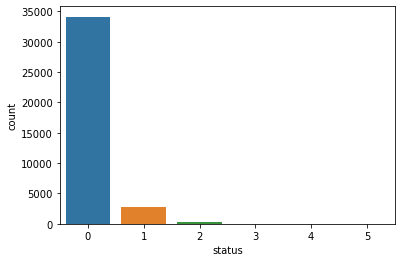

In [147]:
sns.countplot(data.status)

In [148]:
data = data[data["status"]!= 2]
data = data[data["status"]!= 3]
data = data[data["status"]!= 4]
data = data[data["status"]!= 5]
data

,status,budget,_minbudget_,_maxbudget_,avg_budget,lease_-51 weeks,lease_0,lease_0.5,lease_03 months,lease_06 months,lease_1,lease_1 YEAR,lease_1 month,lease_1 month\,lease_1 week,lease_1 weeks,lease_1 year,lease_1 year .,lease_1 year stay,lease_1 year stay.,lease_1-2 months,lease_10,lease_10 month,lease_10 months,lease_10 weeks,lease_10-15 weeks,lease_10weeks,lease_11,lease_11 months,lease_12,lease_12 month,lease_12 months,lease_12 weeks,lease_12 weeks max,lease_12-16,lease_12-24,lease_125/week,lease_12m,lease_13,lease_130,lease_130/week,lease_14,lease_14 weeks,lease_144,lease_15,lease_15 weeks,lease_150,lease_16,lease_16 week,lease_16 weeks,lease_160/week,lease_17,lease_17 weeks,lease_18,lease_19,lease_19 weeks,lease_1year,lease_2,lease_2 -3weeks,lease_2 month,lease_2 months,lease_2 weeks,lease_2 years,lease_2-3 months,lease_20,lease_20 - 24 weeks,lease_20 weeks,lease_200/week,lease_20weeks,lease_21,lease_22,lease_23,lease_23 weeks,lease_24,lease_24 weeks,lease_24-36,lease_24-44weeks,lease_24-48 weeks,lease_25,lease_25-30 weeks,lease_250,lease_26,lease_27,lease_28,lease_294,lease_2years,lease_3,lease_3 month,lease_3 months,lease_3 weeks,lease_3 years,lease_3-4 months,lease_3-4 weeks,lease_30,lease_30 weeks,lease_31,lease_32,lease_33,lease_33 weeks,lease_34,lease_34 weeks,lease_35,lease_35 weeks,lease_357,lease_36,lease_36 - 44,lease_36-38 weeks,lease_36-40 weeks,lease_37,lease_38,lease_38 Weeks,lease_38 weeks,lease_38-44 weeks,lease_39,lease_39 week,lease_39 weeks,lease_3months,lease_4,lease_4 WEEKS,lease_4 months,lease_4 weeks,lease_4-8 weeks,lease_40,lease_40 - 44 weeks,lease_40 week,lease_40 weekks,lease_40 weeks,lease_40-44,lease_40-44 weeks,lease_40weeks +,lease_41,lease_41 weeks,lease_41weeks,lease_42,lease_42 weeks,lease_42-51,lease_42-52 weeks,lease_43,lease_43 weeks,lease_43/44 weeks,lease_44,lease_44 - 51,lease_44 - 51 weeks,lease_44 WEEKS,lease_44 or 51 weeks,lease_44 week,lease_44 week s,lease_44 week stay,lease_44 weeks,lease_44 weeks/51 weeks,lease_44-51,lease_44-51 weeeks,lease_44-51 weeks,lease_44-51weeks,lease_44-52 weeks,lease_44/51 weeks,lease_44/week,lease_44/weeks,lease_44WEEKS,lease_44week,lease_44weeks,lease_44weeks - 51,lease_45,lease_45 WEEKS,lease_45 or more,lease_45 weeks,lease_45 weeksa,lease_45/week,lease_46,lease_46 week,lease_46 weeks,lease_47,lease_48,lease_48 weeks,lease_49,lease_5,lease_5 months,lease_5-6 months,lease_5-6 weeks,lease_50,lease_50 - 52 weeks,lease_50 weeks,lease_51,lease_51 weeks,lease_51 WEEKS,lease_51 Weeks,lease_51 week,lease_51 weeks,lease_51 weeks ( I don’t mind travelling over an hour),lease_51 weeks \,lease_51 weeks weeks,lease_51 wweeks,lease_51-54weeks,lease_51WEEKS,lease_51Weeks,lease_51\,lease_51sweek,lease_51weeks,lease_52,lease_52 WEEKS,lease_52 weeks,lease_52 weeks],lease_52weeks,lease_53 weeks,lease_55,lease_56,lease_56 weeks,lease_57,lease_58,lease_6,lease_6 month,lease_6 months,lease_6 months (26 weeks),lease_6 motnhs,lease_6 weeks,lease_6-8 months,lease_60,lease_6m to 1 year,lease_6months,lease_6weeks,lease_7 days,lease_7-8 months,lease_70,lease_8,lease_8 weeks,lease_8-12 m,lease_8-12 weeks,lease_84,lease_8months,lease_9,lease_9 months,lease_9-12 months,lease_96,lease_<=8,lease_ASAP,lease_Academic year,lease_Complete Education Year Stay 50 - 52 weeks,lease_FULL YEAR,lease_Full Year,lease_Full Year Course Stay 40 - 44 weeks,lease_Full Year Course Stay 44- 51 weeks,lease_Full Year Course Stay 51 weeks,lease_Full Year Stay,lease_Full time,lease_Full year,lease_Full year stay,lease_London,lease_Long time,lease_N/44,lease_N51,lease_Other,lease_Sem Stay,lease_Sem stay,lease_Semester Stay,lease_Semester Stay 20 - 24 weeks,lease_Semester stay,lease_Short stay,lease_Stay 50 - 52 weeks,lease_Summer/Short Stay 8 - 12 weeks,lease_Until June 2023,lease_Until august,lease_academic year,lease_academic yr,lease_aug,lease_full course,lease_full year,lease_full year stay,lease_full year stayt,lease_full yyear stay,lease_full-course-stay,lease_full-year-stay,lease_lease,lease_lo

In [157]:
data = data.drop(["budget"],axis=1)

In [158]:
data.status.value_counts()

0    34122
1     2782
Name: status, dtype: int64

In [159]:
# plt.figure(figsize=(25,18))
# sns.heatmap(data.corr() , annot=True)

In [160]:
# find the feature importance using Random Forest model

In [161]:
RFC = RandomForestClassifier(n_estimators=200)

In [162]:
RFC.fit(data.drop('status',axis=1) , data.status )

RandomForestClassifier(n_estimators=200)

In [163]:
feature_score = pd.DataFrame(RFC.feature_importances_ , index= data.drop('status',axis=1).columns )

In [164]:
feature_score.columns = ['score']

In [165]:
feature_score.sort_values(by='score', ascending=False)

,score
lost_reason_no_reason,0.527595
lost_reason_Not interested,0.017804
lost_reason_Not responding,0.017392
avg_budget,0.015726
_minbudget_,0.013713
...,...
source_city_a0d9e320c4d870b912dec18f485bbdf03c151722d01c3eb639f15fe3882c0b9c,0.000000
source_city_a0d6e9133cefc708b98ca9252ffd121ad18229056844a60014c2f51f48e6d1a5,0.000000
source_city_a0c06f5907877322a8e7fc2dfc4d2871bc7c61177d3c2f134877e0b376d32e21,0.000000
source_city_a042666f4b95d88c08f5b9e64ee2b353f92ed552156799e135982c944f669f3a,0.000000


In [166]:
x = data.drop('status' , axis=1)
y = data.status

In [167]:
mut_info = mutual_info_classif(x,y)

In [168]:
pd.DataFrame(mut_info , index=x.columns).sort_values(0,ascending=False)

,0
lost_reason_no_reason,0.267418
_minbudget_,0.016388
lost_reason_Not responding,0.015031
lost_reason_Low availability,0.014994
Agent_id_2fca346db656187102ce806ac732e06a62df0dbb2829e511a770556d398e1a6e,0.012906
...,...
source_city_8fd1357d6923c9daac5224f1035f4aecbf2c515c69269d2c622f4749fcf0b982,0.000000
source_city_8ffbd6b7bb40ba5f0a74da90b88e0751327da4773e43ac0ff7e766ebf05d3de9,0.000000
source_city_14ba781f265956ad84fa9ca5d92b01c0a1e9e848cfbdb9a9ee2ee9f1e6d5d4f6,0.000000
movein_01/08/22,0.000000


In [169]:
from sklearn.feature_selection import SelectKBest

In [171]:
x= data.drop('status' , axis=1)
y= data.status

In [172]:
x_train , x_test , y_train ,y_test = train_test_split(x , y, test_size=0.2, stratify=y , random_state= 86252)

In [182]:
# randomized search CV to get best modle
clf_1 = LogisticRegression()
clf_2 = DecisionTreeClassifier()
clf_3 = RandomForestClassifier()
clf_4 = AdaBoostClassifier()

In [183]:
from sklearn.pipeline import Pipeline

In [184]:
Pipe = Pipeline([("classifier", clf_1)])

In [185]:
# for logistic regression
param1 = {}
param1["classifier"] = [clf_1]
param1["classifier__penalty"] = ["11","12"]
param1["classifier__solver"] = ['lbfgs',"liblinear"]
param1["classifier_class_weigth"]= [{0:3,1:7},{0:1,1:9},{0:2,1:8}]
param1

{'classifier': [LogisticRegression()],
 'classifier__penalty': ['11', '12'],
 'classifier__solver': ['lbfgs', 'liblinear'],
 'classifier_class_weigth': [{0: 3, 1: 7}, {0: 1, 1: 9}, {0: 2, 1: 8}]}

In [186]:
# for decision tree
param2 = {}
param2["classifier"]= [clf_2]
param2["classifier__max_depth"]= [3,5,7,8,10,12]
param2["classifier__min_sample_split"] = [2,4,5,7,8,10]
param2["classifier__criterion"] = ["gini","entropy"]
param2["classifier__class_weight"]= [{0:3,1:7},{0:1,1:9},{0.2,0.8}]

In [187]:
# for random forest
param3 = {}
param3["classifier"]=[clf_3]
param3["classifier__max_depth"] =[3,5,7,8,10,12]
param3["classifier__n_estimators"] = [100,200,300,400,500,700]
param3["classifier__min_samples_split"] = [2,4,5,7,8,10]
param3["classifier__criterion"] = ["gini","entropy"]
param3["classifier__class_weight"] = [{0:3,0:7},{0:1,0:9},{0:2,0:8}]

In [188]:
# for Adaboost
param4 = {}
param4["classifier"]=[clf_4]
param4["classifier__n_estimators"] = [50,100,150,200,300,350,400]
param4["classifier__learning_rate"] = [0.5,0.8,1,1.5,2,3]

In [189]:
param = [param1,param2,param3,param4]

In [190]:
rand_cv = RandomizedSearchCV(Pipe,param,cv=10,scoring ="accuracy",n_iter=5, n_jobs = -1, return_train_score= True, )

In [191]:
rand_cv.fit(x,y)

RandomizedSearchCV(cv=10,
                   estimator=Pipeline(steps=[('classifier',
                                              LogisticRegression())]),
                   n_iter=5, n_jobs=-1,
                   param_distributions=[{'classifier': [LogisticRegression()],
                                         'classifier__penalty': ['11', '12'],
                                         'classifier__solver': ['lbfgs',
                                                                'liblinear'],
                                         'classifier_class_weigth': [{0: 3,
                                                                      1: 7},
                                                                     {0: 1,
                                                                      1: 9},
                                                                     {0: 2,
                                                                      1: 8}]},
                                  

In [192]:
rand_cv.best_estimator_

Pipeline(steps=[('classifier',
                 RandomForestClassifier(class_weight={0: 7}, max_depth=8,
                                        min_samples_split=5,
                                        n_estimators=200))])

In [193]:
rand_cv.best_score_

0.924615225344884

In [194]:
rand_cv.best_params_

{'classifier__n_estimators': 200,
 'classifier__min_samples_split': 5,
 'classifier__max_depth': 8,
 'classifier__criterion': 'gini',
 'classifier__class_weight': {0: 7},
 'classifier': RandomForestClassifier(class_weight={0: 7}, max_depth=8, min_samples_split=5,
                        n_estimators=200)}

In [195]:
rand_cv.scorer_

make_scorer(accuracy_score)

In [196]:
data

array([[9.99924660e-01, 7.53396192e-05],
       [9.99979859e-01, 2.01414197e-05],
       [9.99870662e-01, 1.29337967e-04],
       ...,
       [9.99748844e-01, 2.51155518e-04],
       [9.99928645e-01, 7.13547961e-05],
       [9.99319304e-01, 6.80695861e-04]])

In [199]:
accuracy_score(y_test , rand_cv.predict(x_test))



0.9246714537325565

In [201]:
# save model
import pickle
with open("assi.pkl","wb+") as f:
    pickle.dump(rand_cv,f)

In [202]:
pd.read_pickle("assi.pkl")

RandomizedSearchCV(cv=10,
                   estimator=Pipeline(steps=[('classifier',
                                              LogisticRegression())]),
                   n_iter=5, n_jobs=-1,
                   param_distributions=[{'classifier': [LogisticRegression()],
                                         'classifier__penalty': ['11', '12'],
                                         'classifier__solver': ['lbfgs',
                                                                'liblinear'],
                                         'classifier_class_weigth': [{0: 3,
                                                                      1: 7},
                                                                     {0: 1,
                                                                      1: 9},
                                                                     {0: 2,
                                                                      1: 8}]},
                                  

In [203]:
with open("assi.pkl","rb") as f:
    model = pickle.load(f)

In [204]:
model.predict(np.array(list(x_test.iloc[1,:])).reshape(1,-1))[0]

C:\Users\Vijaykumar Gajbhiye\anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


0